## agentのゲームを可視化するnotebo

In [9]:
# Update kaggle-environments to the newest version.
!pip3 install kaggle-environments -U

# GFootball environment.
!apt-get update -y
!apt-get install -y libsdl2-gfx-dev libsdl2-ttf-dev

# Make sure that the Branch in git clone and in wget call matches !!
!git clone -b v2.7 https://github.com/google-research/football.git
!mkdir -p football/third_party/gfootball_engine/lib

!wget https://storage.googleapis.com/gfootball/prebuilt_gameplayfootball_v2.7.so -O football/third_party/gfootball_engine/lib/prebuilt_gameplayfootball.so
!cd football && GFOOTBALL_USE_PREBUILT_SO=1 pip3 install .

Requirement already up-to-date: kaggle-environments in /usr/local/lib/python3.6/dist-packages (1.3.8)
Hit:1 https://cloud.r-project.org/bin/linux/ubuntu bionic-cran40/ InRelease
Ign:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  InRelease
Ign:3 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  InRelease
Hit:4 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu1804/x86_64  Release
Hit:5 https://developer.download.nvidia.com/compute/machine-learning/repos/ubuntu1804/x86_64  Release
Hit:6 http://ppa.launchpad.net/c2d4u.team/c2d4u4.0+/ubuntu bionic InRelease
Get:7 http://security.ubuntu.com/ubuntu bionic-security InRelease [88.7 kB]
Hit:8 http://archive.ubuntu.com/ubuntu bionic InRelease
Get:10 http://archive.ubuntu.com/ubuntu bionic-updates InRelease [88.7 kB]
Hit:11 http://ppa.launchpad.net/graphics-drivers/ppa/ubuntu bionic InRelease
Get:13 http://archive.ubuntu.com/ubuntu bionic-backports InRelease [74.6 k

In [10]:
!pip install pfrl==0.1.0

In [11]:
import os
import sys
import cv2
import collections
import numpy as np
from gfootball.env import observation_preprocessing

# PFRL
import torch
import pfrl

def make_model(path):
    # Q_function
    model = pfrl.q_functions.DistributionalDuelingDQN(n_actions=19, n_atoms=51, v_min=-10, v_max=10, n_input_channels=4)
    
    # Noisy nets
    pfrl.nn.to_factorized_noisy(model, sigma_scale=0.5)
    
    # load weights
    weights = torch.load(path, map_location=torch.device('cpu'))
    model.load_state_dict(weights)
    return model

path = '/content/drive/My Drive/Gfootball/kaggle_simulations/rainbow/agent2/1000000_finish/model.pt'
model = make_model(path)

def agent(obs):
    global model
    
    # Get observations for the first (and only one) player we control.
    obs = obs['players_raw'][0]
    # Agent we trained uses Super Mini Map (SMM) representation.
    # See https://github.com/google-research/seed_rl/blob/master/football/env.py for details.
    obs = observation_preprocessing.generate_smm([obs])[0]
    # preprocess for obs
    obs = cv2.resize(obs, (84,84))    # resize
    obs = np.transpose(obs, [2,0,1])  # transpose to chw
    obs = torch.tensor(obs).float()   # to tensor
    obs = torch.unsqueeze(obs,0)      # add batch

    actions = model(obs)
    action = int(actions.greedy_actions.numpy()[0])  # modified
    return [action]

In [12]:
from kaggle_environments import make
env = make("football", configuration={"save_video": True, "scenario_name": "11_vs_11_kaggle", "running_in_notebook": True}, debug=True)
output = env.run([agent, agent])
print('Left player: action = %s, reward = %s, status = %s, info = %s' % (output[-1][0]["action"], output[-1][0]['reward'], output[-1][0]['status'], output[-1][0]['info']))
print('Right player: action = %s, reward = %s, status = %s, info = %s' % (output[-1][-1]["action"], output[-1][1]['reward'], output[-1][1]['status'], output[-1][1]['info']))
env.render(mode="human", width=800, height=600)

Staring a new environment d55547c0-ee21-4764-a442-4e2a4d36f135: with scenario: 11_vs_11_kaggle
Resetting environment d55547c0-ee21-4764-a442-4e2a4d36f135: with scenario: 11_vs_11_kaggle
Received video link.
Left player: action = [14], reward = 2, status = DONE, info = {}
Right player: action = [17], reward = -2, status = DONE, info = {}


In [13]:
%%writefile visualizer.py
from matplotlib import animation, patches, rcParams
from matplotlib import pyplot as plt
from kaggle_environments.envs.football.helpers import *

WIDTH = 110
HEIGHT = 46.2
PADDING = 10


def initFigure(figwidth=12):
    figheight = figwidth * (HEIGHT + 2 * PADDING) / (WIDTH + 2 * PADDING)

    fig = plt.figure(figsize=(figwidth, figheight))
    ax = plt.axes(xlim=(-PADDING, WIDTH + PADDING), ylim=(-PADDING, HEIGHT + PADDING))
    plt.axis("off")
    return fig, ax


def drawPitch(ax):
    paint = "white"

    # Grass around pitch
    rect = patches.Rectangle((-PADDING / 2, -PADDING / 2), WIDTH + PADDING, HEIGHT + PADDING,
                             lw=1, ec="black", fc="#3f995b", capstyle="round")
    ax.add_patch(rect)

    # Pitch boundaries
    rect = plt.Rectangle((0, 0), WIDTH, HEIGHT, ec=paint, fc="None", lw=2)
    ax.add_patch(rect)

    # Middle line
    plt.plot([WIDTH / 2, WIDTH / 2], [0, HEIGHT], color=paint, lw=2)

    # Dots
    dots_x = [11, WIDTH / 2, WIDTH - 11]
    for x in dots_x:
        plt.plot(x, HEIGHT / 2, "o", color=paint, lw=2)

    # Penalty box
    penalty_box_dim = [16.5, 40.3]
    penalty_box_pos_y = (HEIGHT - penalty_box_dim[1]) / 2

    rect = plt.Rectangle((0, penalty_box_pos_y),
                         penalty_box_dim[0], penalty_box_dim[1], ec=paint, fc="None", lw=2)
    ax.add_patch(rect)
    rect = plt.Rectangle((WIDTH, penalty_box_pos_y), -
                         penalty_box_dim[0], penalty_box_dim[1], ec=paint, fc="None", lw=2)
    ax.add_patch(rect)

    # Goal box
    goal_box_dim = [5.5, penalty_box_dim[1] - 11 * 2]
    goal_box_pos_y = (penalty_box_pos_y + 11)

    rect = plt.Rectangle((0, goal_box_pos_y),
                         goal_box_dim[0], goal_box_dim[1], ec=paint, fc="None", lw=2)
    ax.add_patch(rect)
    rect = plt.Rectangle((WIDTH, goal_box_pos_y),
                         -goal_box_dim[0], goal_box_dim[1], ec=paint, fc="None", lw=2)
    ax.add_patch(rect)

    # Goals
    goal_width = 0.044 / 0.42 * HEIGHT
    goal_pos_y = (HEIGHT / 2 - goal_width / 2)
    rect = plt.Rectangle((0, goal_pos_y), -2, goal_width,
                         ec=paint, fc=paint, lw=2, alpha=0.3)
    ax.add_patch(rect)
    rect = plt.Rectangle((WIDTH, goal_pos_y), 2, goal_width,
                         ec=paint, fc=paint, lw=2, alpha=0.3)
    ax.add_patch(rect)

    # Middle circle
    mid_circle = plt.Circle([WIDTH / 2, HEIGHT / 2], 9.15, color=paint, fc="None", lw=2)
    ax.add_artist(mid_circle)

    # Penalty box arcs
    left = patches.Arc([11, HEIGHT / 2], 2 * 9.15, 2 * 9.15,
                       color=paint, fc="None", lw=2, angle=0, theta1=308, theta2=52)
    ax.add_patch(left)
    right = patches.Arc([WIDTH - 11, HEIGHT / 2], 2 * 9.15, 2 * 9.15,
                        color=paint, fc="None", lw=2, angle=180, theta1=308, theta2=52)
    ax.add_patch(right)

    # Arcs on corners
    corners = [[0, 0], [WIDTH, 0], [WIDTH, HEIGHT], [0, HEIGHT]]
    angle = 0
    for x, y in corners:
        c = patches.Arc([x, y], 2, 2,
                        color=paint, fc="None", lw=2, angle=angle, theta1=0, theta2=90)
        ax.add_patch(c)
        angle += 90


def scale_x(x):
    return (x + 1) * (WIDTH / 2)


def scale_y(y):
    return (y + 0.42) * (HEIGHT / 0.42 / 2)


def extract_data(raw_obs):
    obs = raw_obs[0]["observation"]["players_raw"][0]
    res = dict()
    res["left_team"] = [(scale_x(x), scale_y(y)) for x, y in obs["left_team"]]
    res["right_team"] = [(scale_x(x), scale_y(y)) for x, y in obs["right_team"]]

    ball_x, ball_y, ball_z = obs["ball"]
    res["ball"] = [scale_x(ball_x), scale_y(ball_y), ball_z]
    res["score"] = obs["score"]
    res["steps_left"] = obs["steps_left"]
    res["ball_owned_team"] = obs["ball_owned_team"]

    left_active = raw_obs[0]["observation"]["players_raw"][0]["active"]
    res["left_player"] = res["left_team"][left_active]

    right_active = raw_obs[1]["observation"]["players_raw"][0]["active"]
    res["right_player"] = res["right_team"][right_active]

    res["right_team_roles"] = obs["right_team_roles"]
    res["left_team_roles"] = obs["left_team_roles"]
    res["left_team_direction"] = obs["left_team_direction"]
    res["right_team_direction"] = obs["right_team_direction"]
    res["game_mode"] = GameMode(obs["game_mode"]).name
    return res


def draw_team(obs, team, side):
    x_coords, y_coords = zip(*obs[side])
    team.set_data(x_coords, y_coords)


def draw_ball(obs, ball):
    ball.set_markersize(8 + obs["ball"][2])  # Scale size of ball based on height
    ball.set_data(obs["ball"][:2])


def draw_active_players(obs, left_player, right_player):
    x1, y1 = obs["left_player"]
    left_player.set_data(x1, y1)

    x2, y2 = obs["right_player"]
    right_player.set_data(x2, y2)

    if obs["ball_owned_team"] == 0:
        left_player.set_markerfacecolor("yellow")
        left_player.set_markersize(20)
        right_player.set_markerfacecolor("blue")
        right_player.set_markersize(18)
    elif obs["ball_owned_team"] == 1:
        left_player.set_markerfacecolor("firebrick")
        left_player.set_markersize(18)
        right_player.set_markerfacecolor("yellow")
        right_player.set_markersize(20)
    else:
        left_player.set_markerfacecolor("firebrick")
        left_player.set_markersize(18)
        right_player.set_markerfacecolor("blue")
        right_player.set_markersize(18)


def draw_team_active(obs, team_left_active, team_right_active):
    team_left_active.set_data(WIDTH / 2 - 10, -7)
    team_right_active.set_data(WIDTH / 2 + 10, -7)

    if obs["ball_owned_team"] == 0:
        team_left_active.set_markerfacecolor("firebrick")
    else:
        team_left_active.set_markerfacecolor("mistyrose")

    if obs["ball_owned_team"] == 1:
        team_right_active.set_markerfacecolor("blue")
    else:
        team_right_active.set_markerfacecolor("lightcyan")


def draw_players_directions(obs, directions, side):
    index = 0
    if "right" in side:
        index = 11
    for i, player_dir in enumerate(obs[f"{side}_direction"]):
        x_dir, y_dir = player_dir
        dist = (x_dir ** 2 + y_dir ** 2)**0.5 + 0.00001  # to prevent division by 0
        x = obs[side][i][0]
        y = obs[side][i][1]
        directions[i + index].set_data([x, x + x_dir / dist], [y, y + y_dir / dist])


steps = None
drawings = None
directions = None
ball = left_player = right_player = None
team_left = team_right = None
team_left_active = team_right_active = None
team_left_action = team_right_action = None
text_frame = game_mode = match_info = None


def init():
    ball.set_data([], [])
    left_player.set_data([], [])
    right_player.set_data([], [])
    team_left.set_data([], [])
    team_right.set_data([], [])
    team_left_active.set_data([], [])
    team_right_active.set_data([], [])
    return drawings


def animate(i):
    obs = extract_data(steps[i])

    # Draw info about ball possesion
    draw_active_players(obs, left_player, right_player)
    draw_team_active(obs, team_left_active, team_right_active)

    # Draw players
    draw_team(obs, team_left, "left_team")
    draw_team(obs, team_right, "right_team")

    draw_players_directions(obs, directions, "left_team")
    draw_players_directions(obs, directions, "right_team")

    draw_ball(obs, ball)

    # Draw textual informations
    text_frame.set_text(f"Step {i}/{obs['steps_left'] + i - 1}")
    game_mode.set_text(f"{obs['game_mode']} Mode")

    score_a, score_b = obs["score"]
    match_info.set_text(f"{score_a} : {score_b}")

    # print(steps[i][0]["action"])
    if steps[i][0]["action"]:
        left_action = Action(steps[i][0]["action"][0]).name
    else:
        left_action = Action.Idle.name

    if steps[i][1]["action"]:
        right_action = Action(steps[i][1]["action"][0]).name
    else:
        right_action = Action.Idle.name

    team_left_action.set_text(f"{left_action}")
    team_right_action.set_text(f"{right_action}")

    return drawings


def visualize(trace):
    global steps
    global drawings
    global directions
    global ball, left_player, right_player
    global team_left, team_right
    global team_left_active, team_right_active
    global text_frame, game_mode, match_info
    global team_left_action, team_right_action

    rcParams['font.family'] = 'monospace'
    rcParams['font.size'] = 12

    steps = trace

    fig, ax = initFigure()
    drawPitch(ax)
    ax.invert_yaxis()

    left_player, = ax.plot([], [], "o", ms=18, mfc="firebrick", mew=0, alpha=0.5)
    right_player, = ax.plot([], [], "o", ms=18, mfc="blue", mew=0, alpha=0.5)
    team_left, = ax.plot([], [], "o", ms=12, mfc="firebrick", mew=1, mec="white")
    team_right, = ax.plot([], [], "o", ms=12, mfc="blue", mew=1, mec="white")
    ball, = ax.plot([], [], "o", ms=8, mfc="wheat", mew=1, mec="black")

    team_left_active, = ax.plot([], [], "o", ms=16, mfc="mistyrose", mec="None")
    team_right_active, = ax.plot([], [], "o", ms=16, mfc="lightcyan", mec="None")

    textheight = -6
    text_frame = ax.text(-5, textheight, "", ha="left")
    match_info = ax.text(WIDTH / 2, textheight, "", ha="center")
    game_mode = ax.text(WIDTH + 5, textheight, "", ha="right")

    team_left_action = ax.text(WIDTH / 2 - 30, textheight, "", ha="center")
    team_right_action = ax.text(WIDTH / 2 + 30, textheight, "", ha="center")

    # Drawing of directions definitely can be done in a better way
    directions = []
    for _ in range(22):
        direction, = ax.plot([], [], color="yellow", lw=1.5)
        directions.append(direction)

    drawings = [team_left_active, team_right_active, left_player, right_player,
                team_left, team_right, ball, text_frame, match_info,
                game_mode, team_left_action, team_right_action]

    fig.subplots_adjust(left=0, bottom=0, right=1, top=1, wspace=None, hspace=None)
    anim = animation.FuncAnimation(fig, animate, init_func=init, blit=True,
                                   interval=100, frames=len(steps), repeat=False)
    return anim

Writing visualizer.py


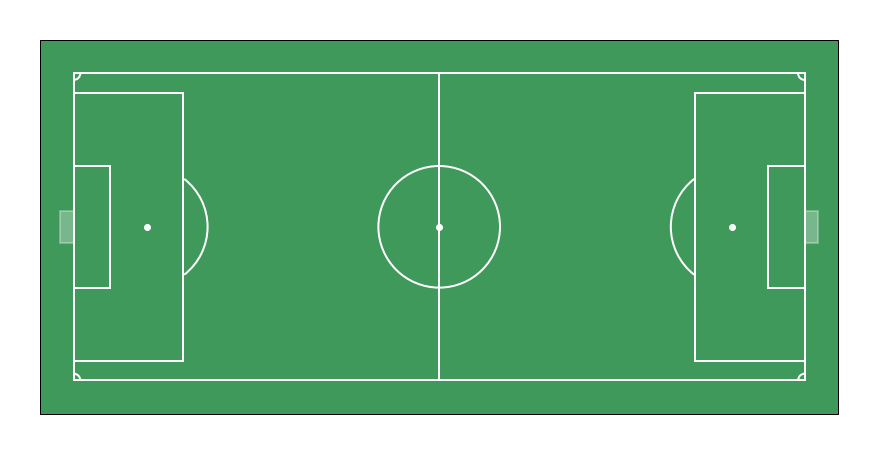

In [14]:
from IPython.display import HTML
from visualizer import visualize
viz = visualize(output)

In [15]:
HTML(viz.to_html5_video())